# Exploratory data analysis (EDA) - Разведочный анализ данных

## Data Visualization

In [1]:
import matplotlib as mpl
import seaborn as sns

import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
plt.style.use('seaborn-v0_8')
mpl.rcParams['font.family'] = 'serif'
%config InlineBackend.figure_format = 'svg'

In [3]:
# !pip3 install cufflinks

In [4]:
import cufflinks as cf
cf.set_config_file(offline=True)

In [5]:
import scipy.stats as scs
import statsmodels.api as sm
import math

In [6]:
import warnings
warnings.simplefilter('ignore')

## Financial Plotting

## Day

In [7]:
stock = ['GAZP', 'ROSN', 'SBERP', 'RTKMP', 'MOEX']

In [8]:
for i in stock:
    h = pd.read_csv(f'{i}_day.csv', index_col=0, parse_dates=True)
    quotes = h[['OPEN', 'HIGH', 'LOW', 'CLOSE']]
    quotes = quotes.iloc[-60:]
    qf = cf.QuantFig(quotes, title=f'{i} Exchange Rate', legend='top', name = i)
#     qf.iplot()
    qf.add_bollinger_bands(periods=15,
                       boll_std=2)

#     qf.iplot()
    qf.add_rsi(periods=14,
          showbands=False)

    qf.iplot()

## Hour

In [9]:
for i in stock:
    h = pd.read_csv(f'{i}_hour.csv', index_col=0, parse_dates=True)
    quotes = h[['OPEN', 'HIGH', 'LOW', 'CLOSE']]
    quotes = quotes.iloc[-60:]
    qf = cf.QuantFig(quotes, title=f'{i} Exchange Rate', legend='top', name = i)
#     qf.iplot()
    qf.add_bollinger_bands(periods=15,
                       boll_std=2)

#     qf.iplot()
    qf.add_rsi(periods=14,
          showbands=False)

    qf.iplot()

# min

In [10]:
for i in stock:
    h = pd.read_csv(f'{i}_min.csv', index_col=0, parse_dates=True)
    quotes = h[['OPEN', 'HIGH', 'LOW', 'CLOSE']]
    quotes = quotes.iloc[-60:]
    qf = cf.QuantFig(quotes, title=f'{i} Exchange Rate', legend='top', name = i)
#     qf.iplot()
    qf.add_bollinger_bands(periods=15,
                       boll_std=2)

#     qf.iplot()
    qf.add_rsi(periods=14,
          showbands=False)

    qf.iplot()

## Financial Data

In [11]:
data1 = pd.read_csv('stock_day.csv',  
                   index_col=0, 
                   parse_dates=True)  

data1

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2013-01-08,147.90,268.98,70.38,92.50,NaN
2013-01-09,148.91,268.99,70.69,92.03,NaN
2013-01-10,147.60,266.65,70.90,91.00,NaN
2013-01-11,147.97,265.28,71.32,90.01,NaN
2013-01-14,149.60,267.00,72.47,90.56,NaN
...,...,...,...,...,...
2023-11-09,168.16,583.10,276.05,74.10,205.11
2023-11-10,168.25,598.30,279.30,74.30,211.10
2023-11-13,167.85,598.30,282.74,76.35,202.49


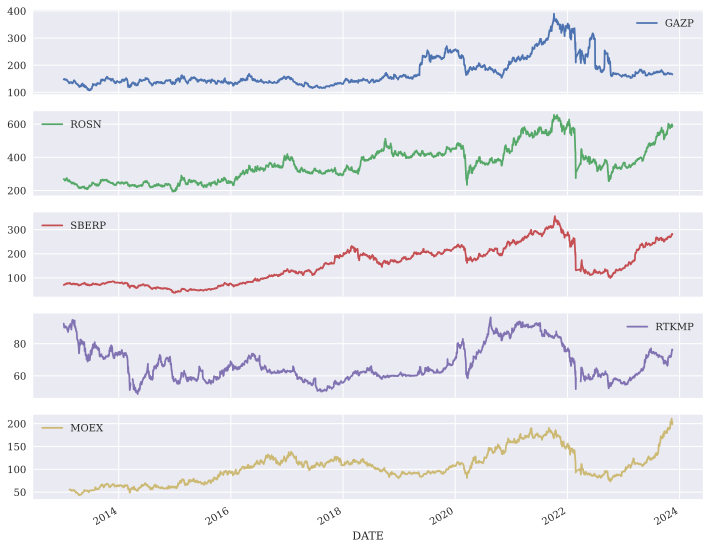

In [12]:
data1.plot(figsize=(12, 10), subplots=True);  

### Summary Statistics

In [13]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2721 entries, 2013-01-08 to 2023-11-15
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   GAZP    2721 non-null   float64
 1   ROSN    2721 non-null   float64
 2   SBERP   2721 non-null   float64
 3   RTKMP   2710 non-null   float64
 4   MOEX    2693 non-null   float64
dtypes: float64(5)
memory usage: 127.5 KB


In [14]:
data1.describe().round(2)  

,GAZP,ROSN,SBERP,RTKMP,MOEX
count,2721.00,2721.00,2721.00,2710.00,2693.00
mean,174.24,360.80,152.27,67.55,104.69
std,54.69,106.72,76.09,11.06,34.79
min,107.23,193.20,37.70,48.69,43.03
25%,138.50,260.85,76.82,59.52,80.00
50%,152.05,345.00,144.97,63.60,102.37
75%,189.67,422.00,209.00,73.83,120.51
max,389.82,655.25,356.00,96.35,211.10


In [15]:
data1.mean()  

GAZP     174.238221
ROSN     360.798581
SBERP    152.271301
RTKMP     67.545011
MOEX     104.694241
dtype: float64

In [16]:
data1.aggregate([min,  
                np.mean,  
                np.std,  
                np.median,  
                max]  
).round(2)

,GAZP,ROSN,SBERP,RTKMP,MOEX
min,107.23,193.20,37.70,48.69,43.03
mean,174.24,360.80,152.27,67.55,104.69
std,54.69,106.72,76.09,11.06,34.79
median,152.05,345.00,144.97,63.60,102.37
max,389.82,655.25,356.00,96.35,211.10


### Changes Over Time

In [17]:
data1.diff().tail(7)

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-07,-0.95,-5.00,-0.14,0.55,-0.15
2023-11-08,-0.04,-2.30,4.24,0.15,-1.29
2023-11-09,-0.33,1.45,-0.80,1.40,1.06
2023-11-10,0.09,15.20,3.25,0.20,5.99
2023-11-13,-0.40,0.00,3.44,2.05,-8.61
2023-11-14,-1.99,-7.00,-3.20,-0.55,-4.08
2023-11-15,0.60,-6.30,1.95,0.55,4.38


In [18]:
data1.pct_change().round(3).tail(7)

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-07,-0.006,-0.008,-0.001,0.008,-0.001
2023-11-08,-0.000,-0.004,0.016,0.002,-0.006
2023-11-09,-0.002,0.002,-0.003,0.019,0.005
2023-11-10,0.001,0.026,0.012,0.003,0.029
2023-11-13,-0.002,0.000,0.012,0.028,-0.041
2023-11-14,-0.012,-0.012,-0.011,-0.007,-0.020
2023-11-15,0.004,-0.011,0.007,0.007,0.022


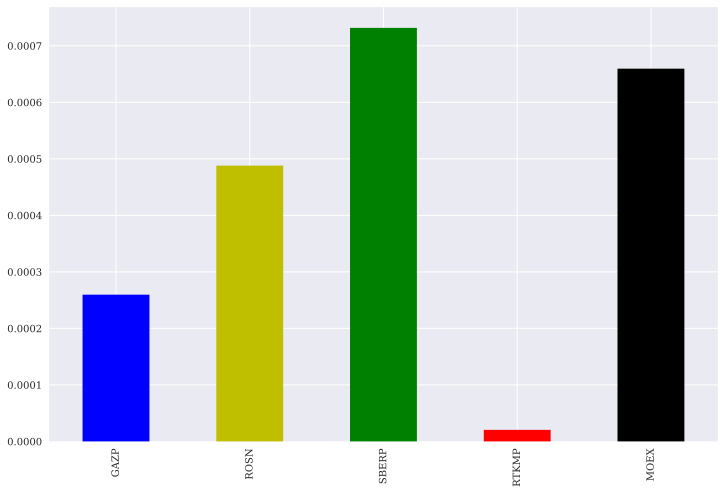

In [19]:
data1.pct_change().mean().plot(kind='bar', color=['blue', 'y', 'green', 'red', 'black'], figsize=(12, 8));

In [20]:
rets = np.log(data1 / data1.shift(1))  

In [21]:
rets.tail().round(3)

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-09,-0.002,0.002,-0.003,0.019,0.005
2023-11-10,0.001,0.026,0.012,0.003,0.029
2023-11-13,-0.002,0.000,0.012,0.027,-0.042
2023-11-14,-0.012,-0.012,-0.011,-0.007,-0.020
2023-11-15,0.004,-0.011,0.007,0.007,0.022


In [22]:
rets.cumsum().apply(np.exp).iplot();  
# plt.savefig('../../images/ch08/fts_03.png');

### Resampling

In [23]:
data1.resample('1w', label='right').last()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2013-01-13,147.97,265.28,71.32,90.01,NaN
2013-01-20,148.42,262.44,74.68,90.85,NaN
2013-01-27,146.40,272.62,75.10,90.00,NaN
2013-02-03,142.28,262.01,76.83,88.90,NaN
2013-02-10,137.68,255.61,76.69,88.49,NaN
...,...,...,...,...,...
2023-10-22,171.39,602.90,269.57,71.50,189.18
2023-10-29,167.26,594.60,269.24,72.60,191.50
2023-11-05,169.19,581.50,268.39,71.60,203.93


In [24]:
data1.resample('1m', label='right').last()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2013-01-31,142.09,267.15,78.11,88.59,NaN
2013-02-28,137.40,244.01,74.34,91.49,53.89
2013-03-31,134.08,238.66,75.12,87.89,49.48
2013-04-30,124.15,214.38,72.38,82.58,44.41
2013-05-31,123.40,211.50,72.60,72.62,53.37
...,...,...,...,...,...
2023-07-31,174.33,508.75,265.29,74.45,134.00
2023-08-31,177.99,556.15,264.75,72.15,172.25
2023-09-30,167.09,537.00,260.41,69.50,179.03


In [25]:
rets.cumsum().apply(np.exp).resample('1m', label='right').last(
                          ).iplot();  
# plt.savefig('../../images/ch08/fts_04.png');

# Rolling Statistics

In [26]:
for sym in stock:
    window = 20
    data2 = pd.DataFrame(data1[sym]).dropna()
    data2['min'] = data2[sym].rolling(window=window).min()  
    data2['mean'] = data2[sym].rolling(window=window).mean()  
    data2['std'] = data2[sym].rolling(window=window).std()  
    data2['median'] = data2[sym].rolling(window=window).median()  
    data2['max'] = data2[sym].rolling(window=window).max()  
    data2['ewma'] = data2[sym].ewm(halflife=0.5, min_periods=window).mean()  
    display(data2.dropna().tail(7))

,GAZP,min,mean,std,median,max,ewma
DATE,,,,,,,
2023-11-07,168.53,167.16,169.5235,1.485053,169.560,172.55,168.738721
2023-11-08,168.49,167.16,169.5535,1.456095,169.560,172.55,168.552180
2023-11-09,168.16,167.16,169.4865,1.489141,169.550,172.55,168.258045
2023-11-10,168.25,167.16,169.3890,1.503732,169.335,172.55,168.252011
2023-11-13,167.85,167.16,169.1540,1.342329,168.860,171.97,167.950503
2023-11-14,165.86,165.86,168.8485,1.362835,168.510,171.39,166.382626
2023-11-15,166.46,165.86,168.6625,1.424026,168.470,171.39,166.440656


,ROSN,min,mean,std,median,max,ewma
DATE,,,,,,,
2023-11-07,583.95,540.35,580.2200,15.894499,585.075,602.9,584.780782
2023-11-08,581.65,546.05,582.2850,12.829264,585.075,602.9,582.432696
2023-11-09,583.10,561.85,584.1375,9.586900,585.075,602.9,582.933174
2023-11-10,598.30,568.65,585.9600,8.533766,586.225,602.9,594.458293
2023-11-13,598.30,573.05,587.4425,7.921860,586.525,602.9,597.339573
2023-11-14,591.30,574.55,588.3550,7.194459,587.000,602.9,592.809893
2023-11-15,585.00,574.55,588.2650,7.226124,586.725,602.9,586.952473


,SBERP,min,mean,std,median,max,ewma
DATE,,,,,,,
2023-11-07,272.61,260.16,268.5720,3.128966,269.115,272.87,272.375790
2023-11-08,276.85,263.21,269.4065,2.989929,269.180,276.85,275.731448
2023-11-09,276.05,263.21,270.0085,3.057516,269.405,276.85,275.970362
2023-11-10,279.30,267.55,270.8130,3.283031,269.585,279.30,278.467590
2023-11-13,282.74,267.55,271.5480,4.158358,269.675,282.74,281.671898
2023-11-14,279.54,267.55,272.0275,4.503022,269.675,282.74,280.072974
2023-11-15,281.49,267.93,272.7245,4.839757,270.300,282.74,281.135744


,RTKMP,min,mean,std,median,max,ewma
DATE,,,,,,,
2023-11-07,72.55,66.25,70.7525,2.031299,71.675,72.60,72.390426
2023-11-08,72.70,66.25,70.9875,1.966956,71.750,72.70,72.622607
2023-11-09,74.10,66.25,71.3425,1.846424,71.800,74.10,73.730652
2023-11-10,74.30,66.90,71.7450,1.527804,71.900,74.30,74.157663
2023-11-13,76.35,69.60,72.2175,1.407057,71.950,76.35,75.801916
2023-11-14,75.80,70.75,72.5275,1.481062,71.975,76.35,75.800479
2023-11-15,76.35,71.25,72.8075,1.647348,72.000,76.35,76.212620


,MOEX,min,mean,std,median,max,ewma
DATE,,,,,,,
2023-11-07,205.34,179.20,191.5690,6.873931,189.960,205.49,205.182842
2023-11-08,204.05,185.60,192.8115,6.765527,190.305,205.49,204.333211
2023-11-09,205.11,185.60,193.7395,7.124818,190.545,205.49,204.915803
2023-11-10,211.10,186.78,195.0145,7.837564,191.095,211.10,209.553951
2023-11-13,202.49,186.78,195.7205,7.843488,191.545,211.10,204.255988
2023-11-14,198.41,186.78,196.1065,7.772533,192.240,211.10,199.871497
2023-11-15,202.79,186.78,196.7355,7.779260,195.650,211.10,202.060374


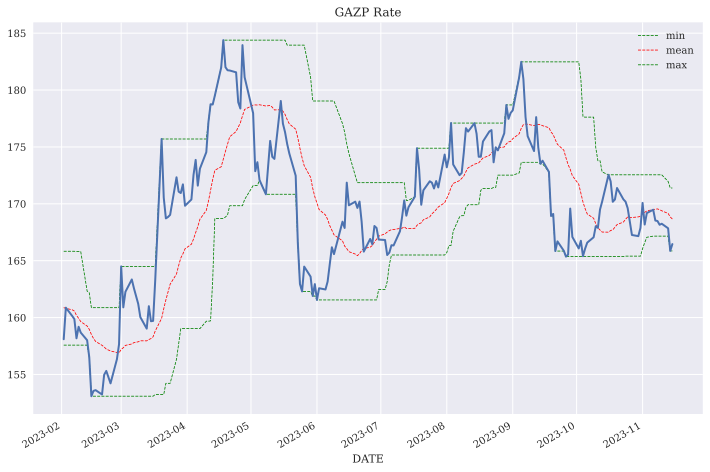

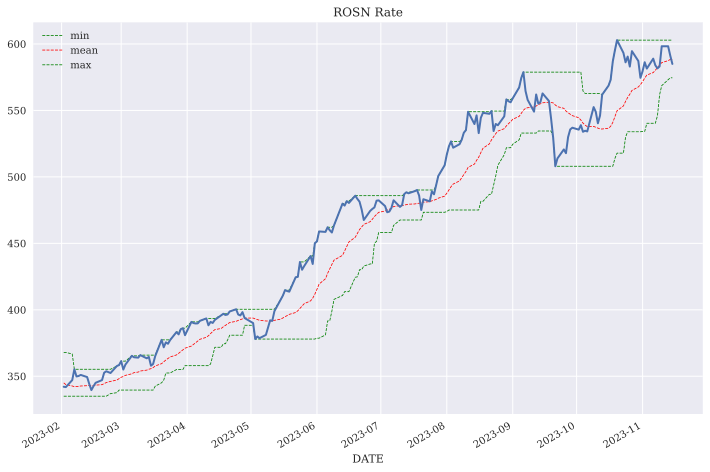

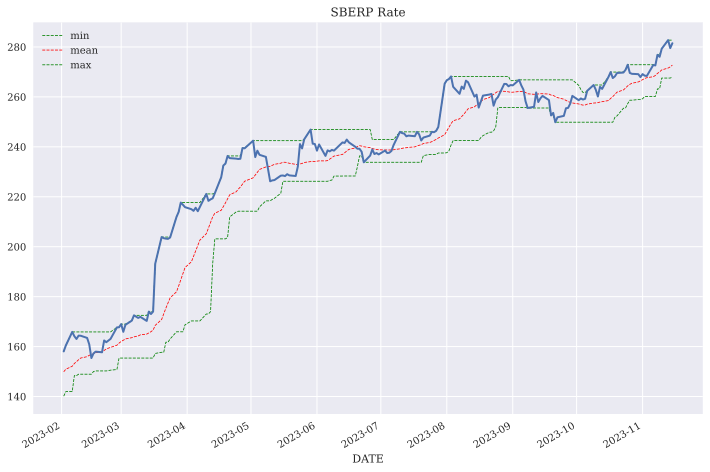

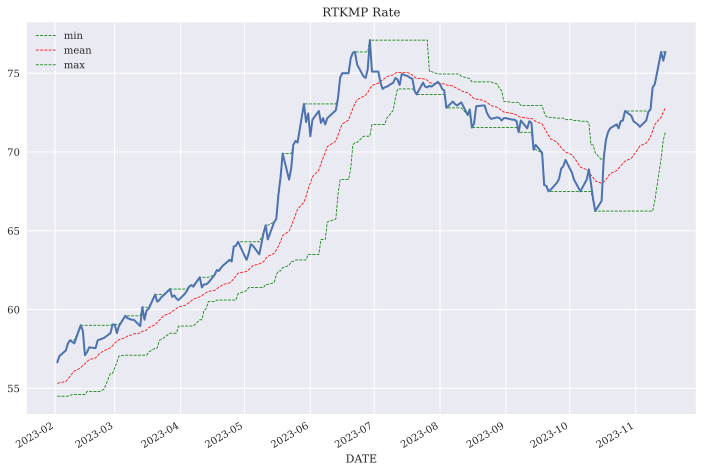

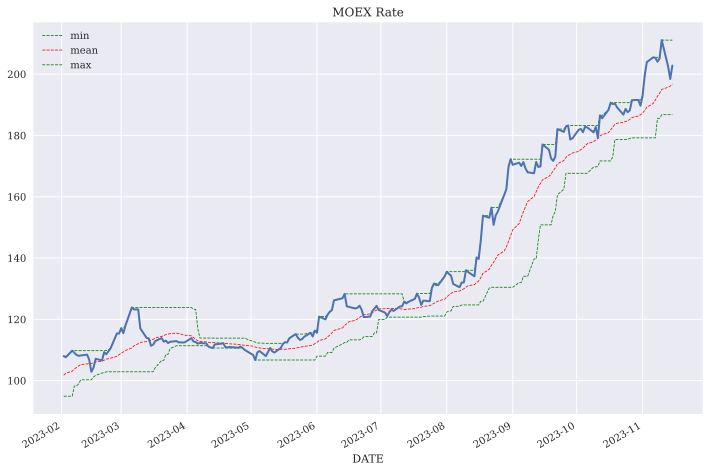

In [27]:
for sym in stock:
    window = 20
    data2 = pd.DataFrame(data1[sym]).dropna()
    data2['min'] = data2[sym].rolling(window=window).min()  
    data2['mean'] = data2[sym].rolling(window=window).mean()  
    data2['std'] = data2[sym].rolling(window=window).std()  
    data2['median'] = data2[sym].rolling(window=window).median()  
    data2['max'] = data2[sym].rolling(window=window).max()  
    data2['ewma'] = data2[sym].ewm(halflife=0.5, min_periods=window).mean()  
    data2.dropna()
    ax = data2[['min', 'mean', 'max']].iloc[-200:].plot(title=f'{sym} Rate',
        figsize=(12, 8), style=['g--', 'r--', 'g--'], lw=0.8)  
    data2[sym].iloc[-200:].plot(ax=ax, lw=2.0);  
# plt.savefig('../../images/ch08/fts_05.png');

# A Technical Analysis Example

In [28]:
from itertools import product

In [29]:
sma1 = range(20, 61, 4)  
sma2 = range(180, 281, 10)  

In [30]:
ress = []
for sym in stock:
    res = {}
    res['stock'] = sym
#     print('\nResults for symbol {}'.format(sym))
#     print(30 * '-')
    results = pd.DataFrame()
    for SMA1, SMA2 in product(sma1, sma2):  
        data3 = pd.DataFrame(data1[sym])
        data3.dropna(inplace=True)
        data3['Returns'] = np.log(data3[sym] / data3[sym].shift(1))
        data3['SMA1'] = data3[sym].rolling(SMA1).mean()
        data3['SMA2'] = data3[sym].rolling(SMA2).mean()
        data3.dropna(inplace=True)
        data3['Position'] = np.where(data3['SMA1'] > data3['SMA2'], 1, -1)
        data3['Strategy'] = data3['Position'].shift(1) * data3['Returns']
        data3.dropna(inplace=True)
        perf = np.exp(data3[['Returns', 'Strategy']].sum())
        results = results.append(pd.DataFrame(
                    {'SMA1': SMA1, 'SMA2': SMA2,
                     'MARKET': perf['Returns'],
                     'STRATEGY': perf['Strategy'],
                     'OUT': perf['Strategy'] - perf['Returns']},
                     index=[0]), ignore_index=True)
    results = results.sort_values('OUT', ascending=False).head(1)
#     print(results['STRATEGY'].values[0])
    res['SMA1'] = results['SMA1'].values[0]
    res['SMA2'] = results['SMA2'].values[0]
    res['MARKET'] = results['MARKET'].values[0]
    res['STRATEGY'] = results['STRATEGY'].values[0]
    res['OUT'] = results['OUT'].values[0]  
#     display(results)
    ress.append(res)
#     print(30 * '-')

In [31]:
df1 = pd.DataFrame.from_dict(ress)
df1.set_index('stock', inplace=True)
df1

,SMA1,SMA2,MARKET,STRATEGY,OUT
stock,,,,,
GAZP,24,180,1.126938,1.513097,0.386159
ROSN,60,200,2.241723,1.923979,-0.317744
SBERP,44,180,3.618589,18.379963,14.761374
RTKMP,24,210,1.009921,2.620832,1.610911
MOEX,60,220,3.217867,8.328599,5.110732


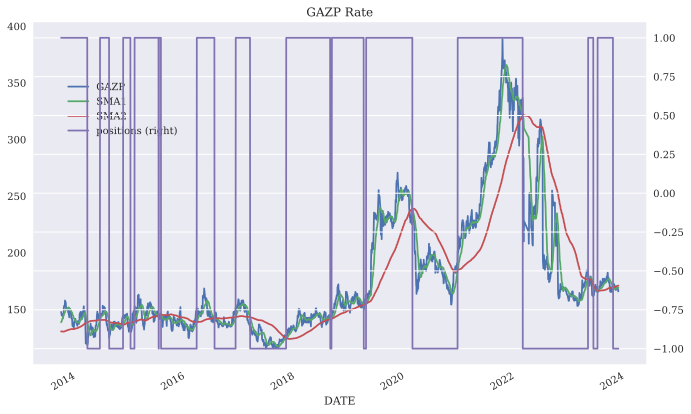

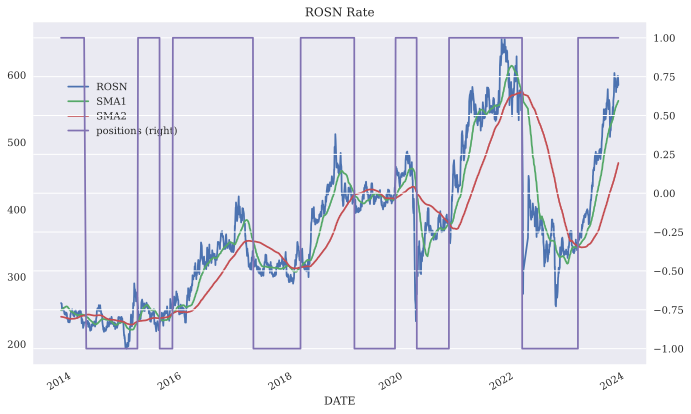

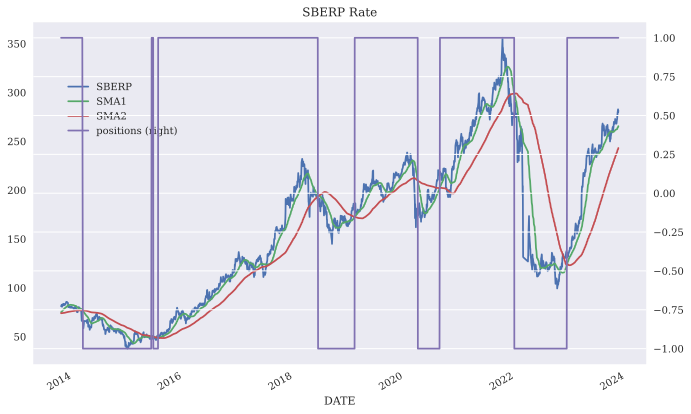

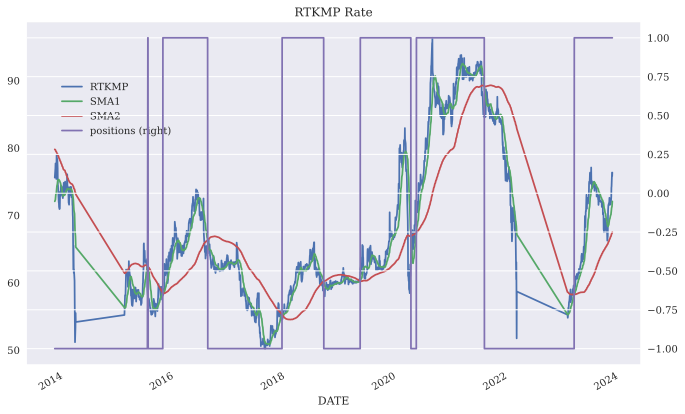

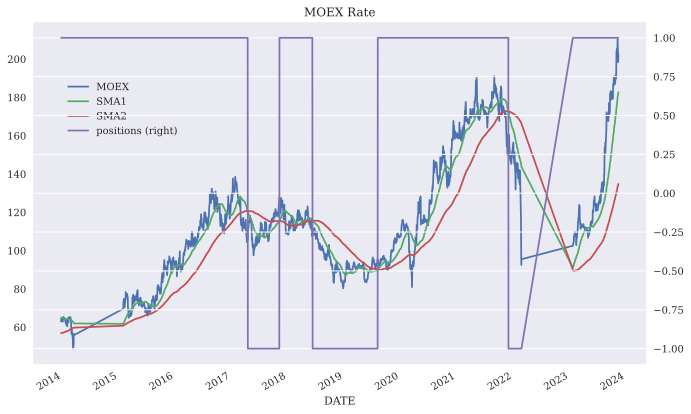

In [32]:
data = data1.copy()
for sym in stock:
    
    data['SMA1'] = data1[sym].rolling(window=df1.loc[sym, 'SMA1']).mean()  
    data['SMA2'] = data1[sym].rolling(window=df1.loc[sym, 'SMA2']).mean()  
    data.dropna(inplace=True)
    data['positions'] = np.where(data['SMA1'] > data['SMA2'],  
                             1,  
                             -1)  
    ax = data[[sym, 'SMA1', 'SMA2', 'positions']].plot(title=f'{sym} Rate', figsize=(11, 7),
                                              secondary_y='positions')
    ax.get_legend().set_bbox_to_anchor((0.25, 0.85));

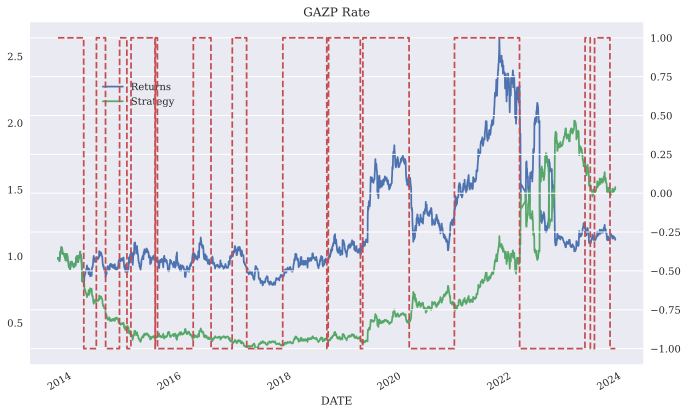

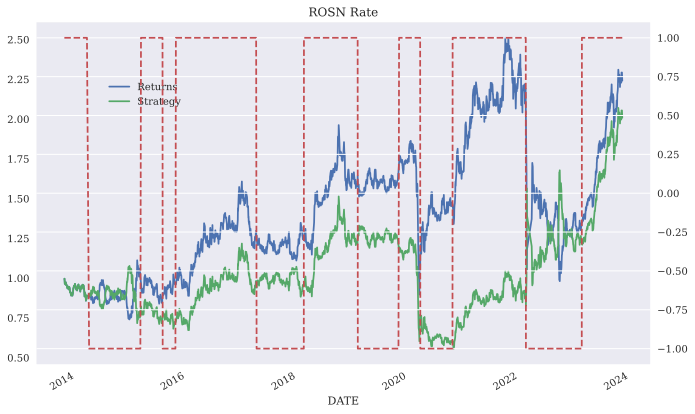

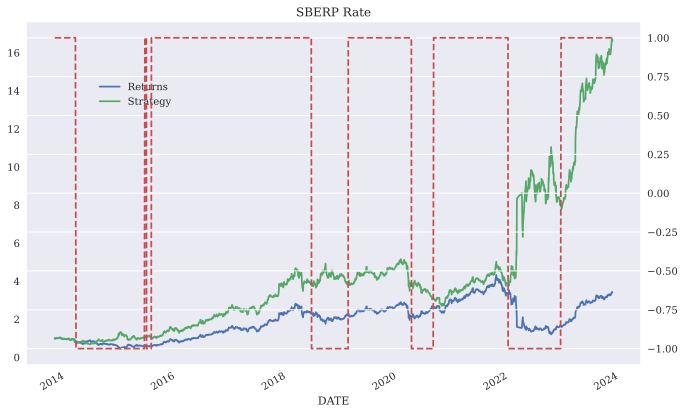

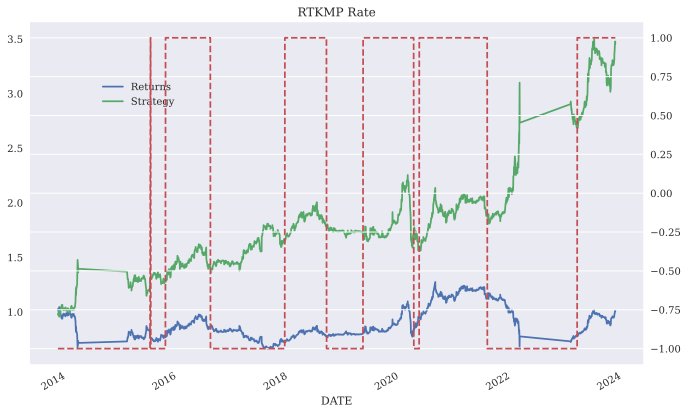

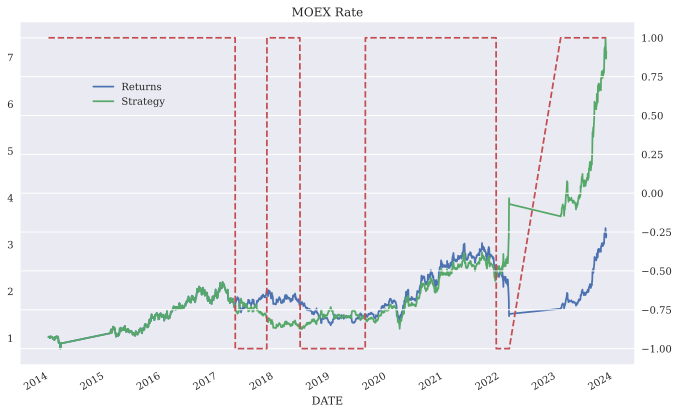

In [33]:
data = data1.copy()
for sym in stock:
    
    data['SMA1'] = data1[sym].rolling(window=df1.loc[sym, 'SMA1']).mean()  
    data['SMA2'] = data1[sym].rolling(window=df1.loc[sym, 'SMA2']).mean()  
    data.dropna(inplace=True)
    data['Position'] = np.where(data['SMA1'] > data['SMA2'],  
                             1,  
                             -1)  
    data['Returns'] = np.log(data[sym] / data[sym].shift(1)) 
    data['Strategy'] = data['Position'].shift(1) * data['Returns']  
    data.dropna(inplace=True)
    ax = data[['Returns', 'Strategy']].cumsum(
        ).apply(np.exp).plot(figsize=(11, 7))
    data['Position'].plot(title=f'{sym} Rate', ax=ax, secondary_y='Position', style='--')
    ax.get_legend().set_bbox_to_anchor((0.25, 0.85));

## Regression Analysis

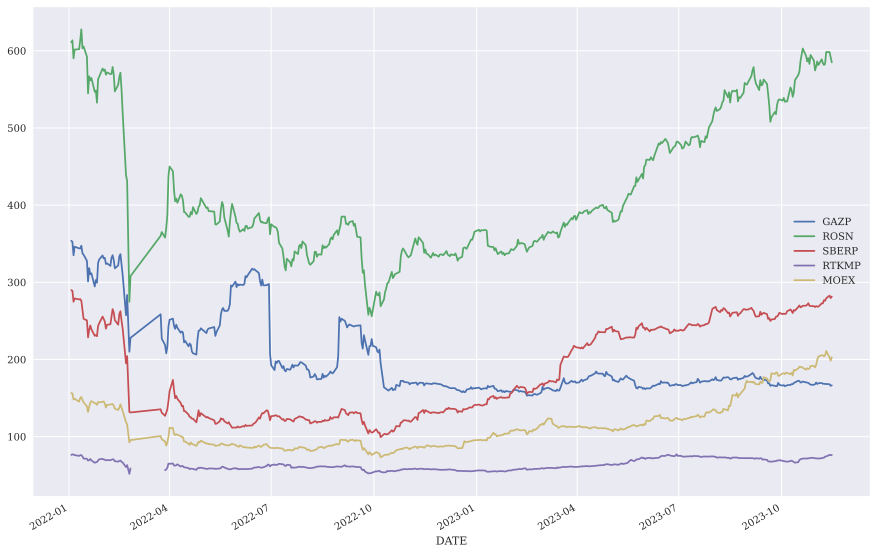

In [34]:
data1.loc['2022-01-01':].plot(figsize=(15, 10));  
# plt.savefig('../../images/ch08/fts_09.png');

In [35]:
rets1 = np.log(data1 / data1.shift(1)) 
rets1.dropna(inplace=True)
rets1.tail()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-09,-0.001960,0.002490,-0.002894,0.019074,0.005181
2023-11-10,0.000535,0.025734,0.011704,0.002695,0.028786
2023-11-13,-0.002380,0.000000,0.012241,0.027217,-0.041641
2023-11-14,-0.011927,-0.011769,-0.011382,-0.007230,-0.020355
2023-11-15,0.003611,-0.010712,0.006952,0.007230,0.021835


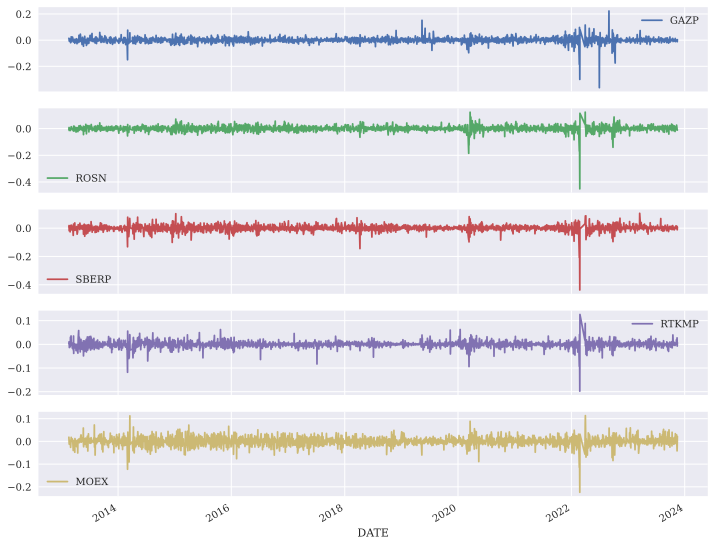

In [36]:
rets1.plot(subplots=True, figsize=(12, 10));
# plt.savefig('../../images/ch08/fts_10.png');

In [37]:
pd.plotting.scatter_matrix(rets1,  
                           alpha=0.2,  
                           diagonal='hist',  
                           hist_kwds={'bins': 35},  
                           figsize=(10, 8));
# plt.savefig('../../images/ch08/fts_11.png');

## Correlation

## Ковариация и корреляция

In [38]:
result = data1.copy()

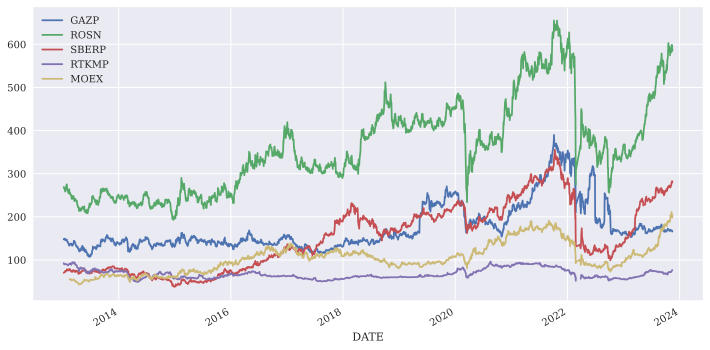

In [39]:
result.plot(figsize=(12,6))
plt.show()

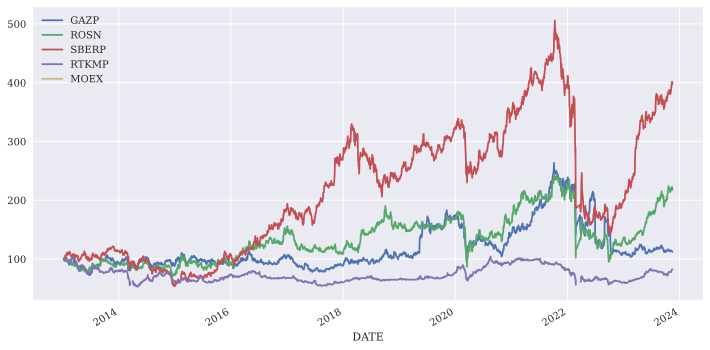

In [40]:
(result / result.iloc[0] * 100).plot(figsize = (12, 6));
plt.show()

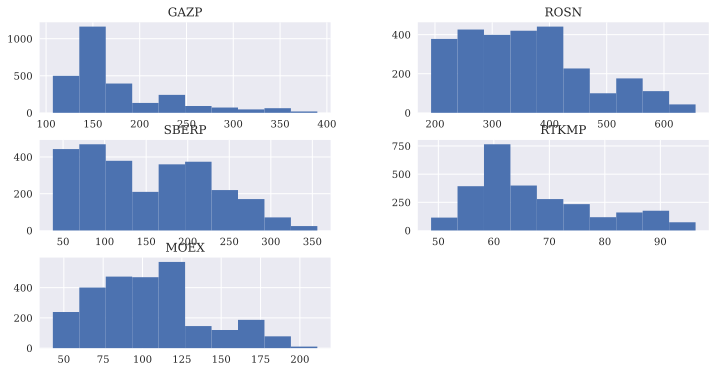

In [41]:
result.hist(figsize=(12,6))
plt.show()

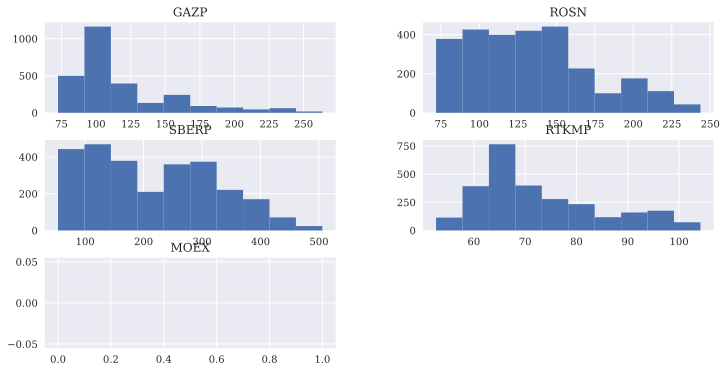

In [42]:
(result / result.iloc[0] * 100).hist(figsize = (12, 6));

In [43]:
returns = (result / result.shift(1)) - 1  # 0+/-
returns.tail()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-09,-0.001959,0.002493,-0.002890,0.019257,0.005195
2023-11-10,0.000535,0.026068,0.011773,0.002699,0.029204
2023-11-13,-0.002377,0.000000,0.012317,0.027591,-0.040786
2023-11-14,-0.011856,-0.011700,-0.011318,-0.007204,-0.020149
2023-11-15,0.003618,-0.010654,0.006976,0.007256,0.022076


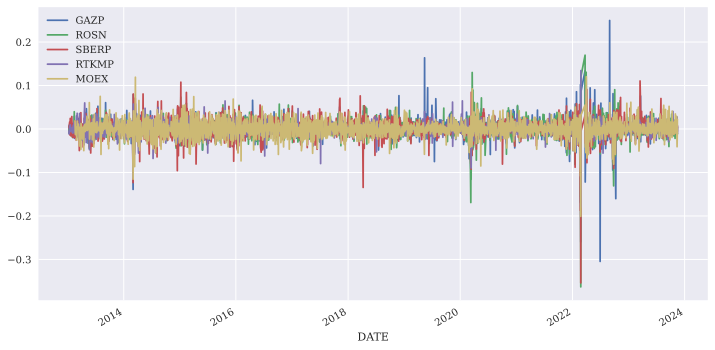

In [44]:
returns.plot(figsize = (12, 6));

In [45]:
result.dropna(inplace = True)

In [46]:
# Годовые доходности
annual_returns = returns.mean() * result.shape[0] # mean in period
annual_returns

GAZP     0.696463
ROSN     1.308832
SBERP    1.962490
RTKMP    0.022005
MOEX     1.768957
dtype: float64

In [47]:
# Строим матрицу ковариаций
cov_matrix_a = returns.cov() * result.shape[0]
cov_matrix_a

,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,1.128282,0.638422,0.620702,0.306212,0.401632
ROSN,0.638422,1.040433,0.633290,0.320551,0.416057
SBERP,0.620702,0.633290,1.143581,0.328181,0.508742
RTKMP,0.306212,0.320551,0.328181,0.478876,0.226820
MOEX,0.401632,0.416057,0.508742,0.226820,0.931289


In [48]:
# Логарифмируем для нормализации распределений и выравнпивания дисперсий
cov_matrix_LOG = np.log(result / result.shift(1)).cov() * result.shape[0]
cov_matrix_LOG

,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,1.164014,0.667949,0.669095,0.333128,0.414388
ROSN,0.667949,1.122206,0.709056,0.344568,0.436283
SBERP,0.669095,0.709056,1.227519,0.361393,0.539115
RTKMP,0.333128,0.344568,0.361393,0.496686,0.242571
MOEX,0.414388,0.436283,0.539115,0.242571,0.940474


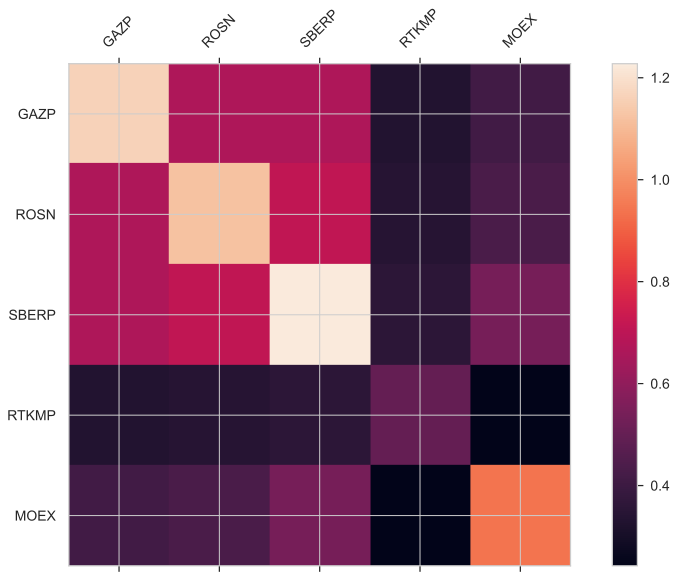

In [49]:
sns.set(style="whitegrid")
plt.figure(figsize=(15, 9))
plt.matshow(cov_matrix_LOG, fignum=1) #annot=True
plt.xticks(range(cov_matrix_LOG.shape[1]), cov_matrix_LOG.columns, fontsize=14, rotation=45)
plt.yticks(range(cov_matrix_LOG.shape[1]), cov_matrix_LOG.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.show()

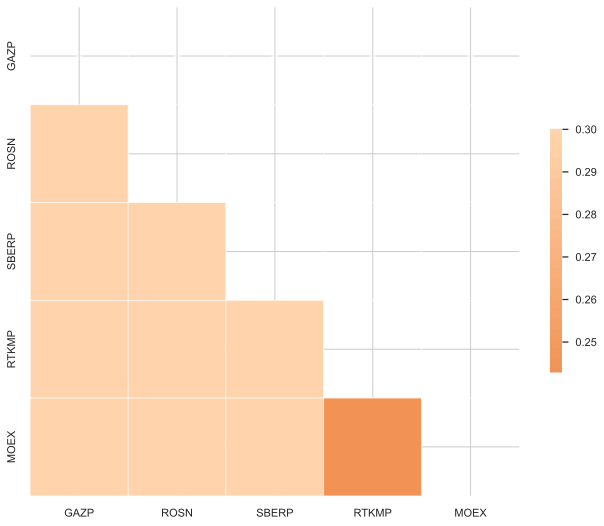

In [50]:
sns.set(style="whitegrid")
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(cov_matrix_LOG, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(cov_matrix_LOG, mask=mask,  vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True,);

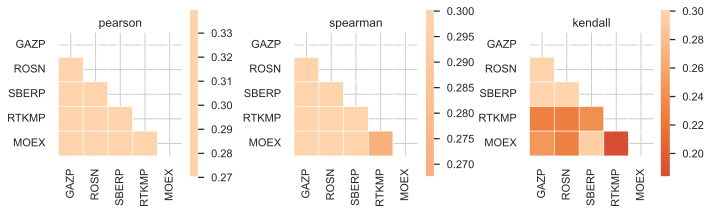

In [51]:
# А что показывает корреляция? 

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(10,5))
sns.set(style="whitegrid")
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(cov_matrix_a, dtype=np.bool))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)

for corr_type, ax in zip(('pearson', "spearman", 'kendall'),(ax1, ax2, ax3)):

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)
    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(returns.corr(method=corr_type), mask=mask,  vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, ax=ax)
    ax.set_title(corr_type)

plt.tight_layout()
plt.show();

In [52]:
tickers = stock[:-1]

In [53]:
# Корреляции с помощью numpy
## For Dimensionality Reduction
correlations = np.abs([np.corrcoef(result["MOEX"],result[col_name])[0,1] for col_name in tickers])
print (list(zip(tickers,correlations)))

[('GAZP', 0.5430403529748252), ('ROSN', 0.829740710491887), ('SBERP', 0.8314498727515998), ('RTKMP', 0.46824244909269114)]


In [54]:
# Не сильно связаны!
correlations[correlations < .8]

array([0.54304035, 0.46824245])

In [55]:
returns.isna().count()

GAZP     2721
ROSN     2721
SBERP    2721
RTKMP    2721
MOEX     2721
dtype: int64

In [56]:
returns.dropna(inplace = True) 
returns

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2013-02-18,0.014255,-0.006155,0.007471,0.002098,0.018545
2013-02-19,0.012141,0.007890,0.018343,0.010580,-0.000357
2013-02-20,-0.003562,-0.014129,-0.018012,0.005998,-0.010714
2013-02-21,-0.007734,-0.003335,-0.009366,-0.013333,-0.012635
2013-02-22,0.005956,0.004023,-0.017466,-0.007800,-0.003656
...,...,...,...,...,...
2023-11-09,-0.001959,0.002493,-0.002890,0.019257,0.005195
2023-11-10,0.000535,0.026068,0.011773,0.002699,0.029204
2023-11-13,-0.002377,0.000000,0.012317,0.027591,-0.040786


In [57]:
# простой способ
[returns['MOEX'].corr(other=returns["SBERP"])]

[0.4905902900668558]

In [58]:
# простой способ
returns.corr()

,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,1.000000,0.586631,0.548152,0.423366,0.383815
ROSN,0.586631,1.000000,0.586357,0.459919,0.419994
SBERP,0.548152,0.586357,1.000000,0.444252,0.490590
RTKMP,0.423366,0.459919,0.444252,1.000000,0.339166
MOEX,0.383815,0.419994,0.490590,0.339166,1.000000


In [59]:
# доверительный интервал
print('доверительный интервал')
print('GAZP = ', returns['GAZP'].sem())
print('ROSN = ', returns['ROSN'].sem())
print('SBERP = ', returns['SBERP'].sem())
print('RTKMP = ', returns['RTKMP'].sem())
print('MOEX = ', returns['MOEX'].sem())

доверительный интервал
GAZP =  0.0003920572212086534
ROSN =  0.0003770506387005637
SBERP =  0.0004000308395594912
RTKMP =  0.00025917357423970973
MOEX =  0.00035912633882136005


In [60]:
# средняя доходность
print('средняя доходность')
print('GAZP = ', returns['GAZP'].mean())
print('ROSN = ', returns['ROSN'].mean())
print('SBERP = ', returns['SBERP'].mean())
print('RTKMP = ', returns['RTKMP'].mean())
print('MOEX = ', returns['MOEX'].mean())

средняя доходность
GAZP =  0.0002817912450256651
ROSN =  0.00045069894431624014
SBERP =  0.0007257598717325653
RTKMP =  1.6009645071375648e-05
MOEX =  0.0006454398100375905


доходность на графике


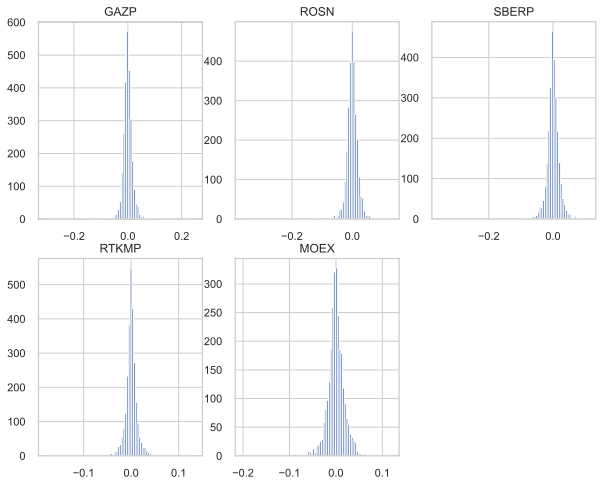

In [61]:
# доходность на графике
print('доходность на графике')
figure = plt.figure(figsize=(10, 8))
for i, p in enumerate(stock):
    figure.add_subplot(2, 3, i+1)
    plt.title(p)
    returns[p].hist( bins=85)
plt.show()

In [62]:
# Выборка  акций с разными типами корреляций
columns = ['pearson', "spearman", 'kendall']
for i in stock:
    sem = []
    for sym in stock:
        s={}
        s[i] = sym
        for corr_type in columns:    
        #     print (corr_type)
              s[corr_type] = [returns[i].corr(other=returns[sym], method=corr_type)][0] #.sem()
        sem.append(s)
    df = pd.DataFrame.from_dict(sem)
    df.set_index(i, inplace=True)
    df = df.drop(i)
    display(df)

,pearson,spearman,kendall
GAZP,,,
ROSN,0.586631,0.550890,0.394840
SBERP,0.548152,0.516640,0.368137
RTKMP,0.423366,0.334049,0.229578
MOEX,0.383815,0.356033,0.245731


,pearson,spearman,kendall
ROSN,,,
GAZP,0.586631,0.550890,0.394840
SBERP,0.586357,0.465948,0.329245
RTKMP,0.459919,0.329859,0.227152
MOEX,0.419994,0.330622,0.227908


,pearson,spearman,kendall
SBERP,,,
GAZP,0.548152,0.516640,0.368137
ROSN,0.586357,0.465948,0.329245
RTKMP,0.444252,0.346177,0.240835
MOEX,0.490590,0.419185,0.293153


,pearson,spearman,kendall
RTKMP,,,
GAZP,0.423366,0.334049,0.229578
ROSN,0.459919,0.329859,0.227152
SBERP,0.444252,0.346177,0.240835
MOEX,0.339166,0.267419,0.183224


,pearson,spearman,kendall
MOEX,,,
GAZP,0.383815,0.356033,0.245731
ROSN,0.419994,0.330622,0.227908
SBERP,0.490590,0.419185,0.293153
RTKMP,0.339166,0.267419,0.183224


### Normality Tests

In [63]:
data1.tail()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-09,168.16,583.1,276.05,74.10,205.11
2023-11-10,168.25,598.3,279.30,74.30,211.10
2023-11-13,167.85,598.3,282.74,76.35,202.49
2023-11-14,165.86,591.3,279.54,75.80,198.41
2023-11-15,166.46,585.0,281.49,76.35,202.79


In [64]:
dat = data1.copy()

In [65]:
# s = dat.values

<Axes: xlabel='DATE'>

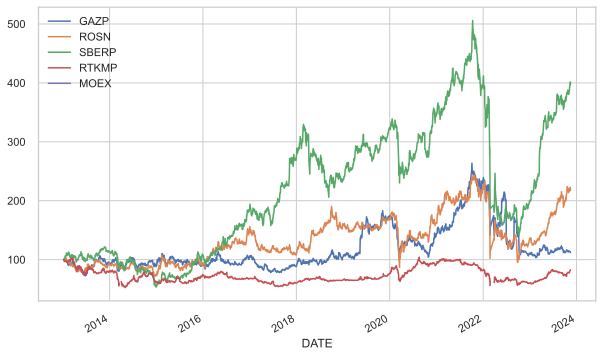

In [66]:
(dat / dat.iloc[0] * 100).plot(figsize=(10, 6))

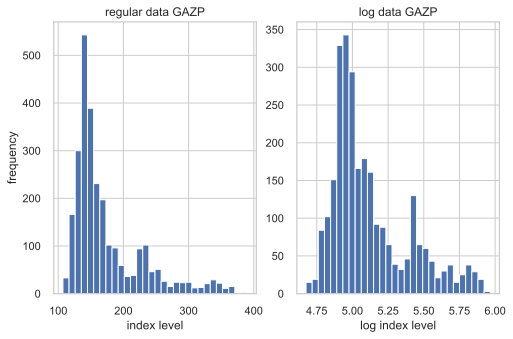

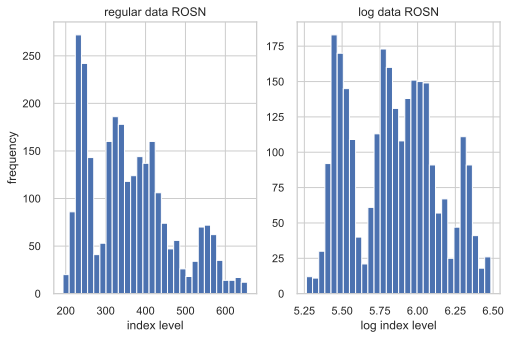

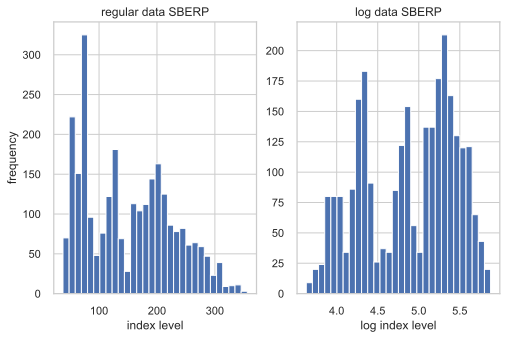

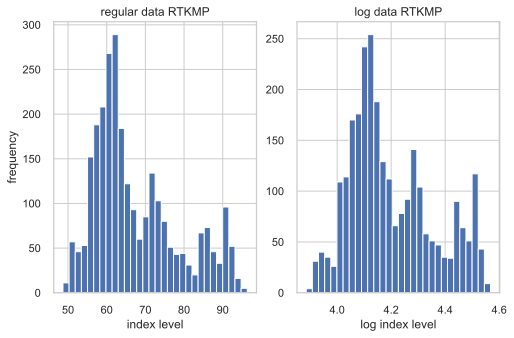

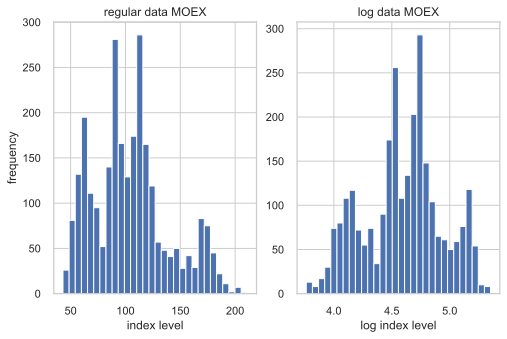

In [67]:
for i in stock:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 5))
    ax1.hist(dat[i].values, bins=30)
    ax1.set_xlabel('index level')
    ax1.set_ylabel('frequency')
    ax1.set_title(f'regular data {i}')
    ax2.hist(np.log(dat[i].values), bins=30)
    ax2.set_xlabel('log index level')
    ax2.set_title(f'log data {i}');

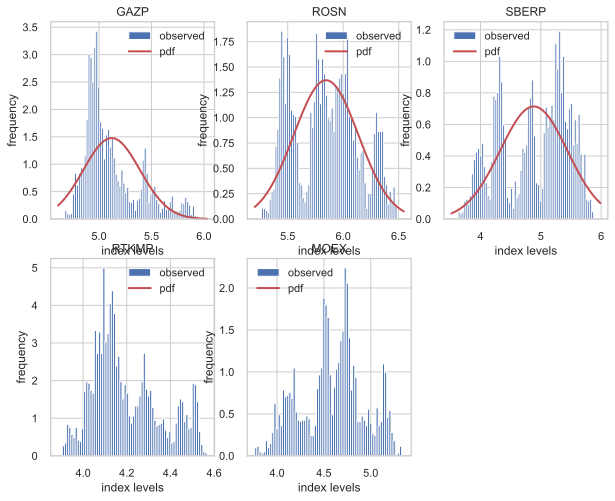

In [68]:
figure = plt.figure(figsize=(10, 8))

for k, i in enumerate(stock):
        figure.add_subplot(2, 3, k+1)
#         plt.figure(figsize=(10, 6))
        log_data = np.log(dat[i].values)
        plt.hist(log_data, bins=70, density=True,
                 label='observed', color='b')
        plt.xlabel('index levels')
        plt.ylabel('frequency')
        x = np.linspace(plt.axis()[0], plt.axis()[1])
        plt.plot(x, scs.norm.pdf(x, log_data.mean(), log_data.std()),
                 'r', lw=2.0, label='pdf')
        plt.title(i)
        plt.legend();
plt.show()

In [69]:
returns = (dat / dat.shift(1))
returns.tail()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-09,0.998041,1.002493,0.997110,1.019257,1.005195
2023-11-10,1.000535,1.026068,1.011773,1.002699,1.029204
2023-11-13,0.997623,1.000000,1.012317,1.027591,0.959214
2023-11-14,0.988144,0.988300,0.988682,0.992796,0.979851
2023-11-15,1.003618,0.989346,1.006976,1.007256,1.022076


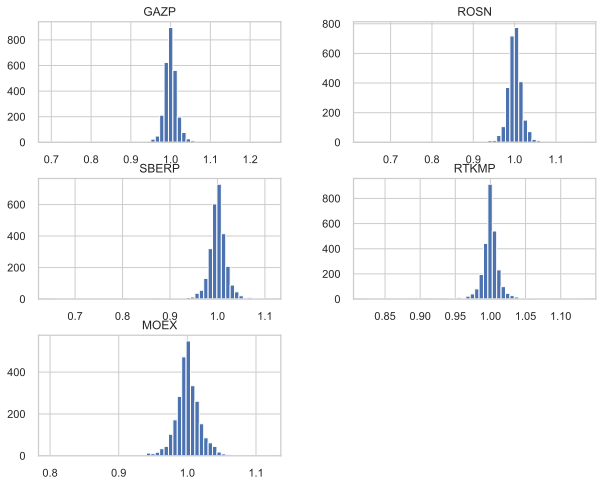

In [70]:
returns.hist(bins=50, figsize=(10, 8));

In [71]:
log_returns = np.log(dat / dat.shift(1))
log_returns.tail()

,GAZP,ROSN,SBERP,RTKMP,MOEX
DATE,,,,,
2023-11-09,-0.001960,0.002490,-0.002894,0.019074,0.005181
2023-11-10,0.000535,0.025734,0.011704,0.002695,0.028786
2023-11-13,-0.002380,0.000000,0.012241,0.027217,-0.041641
2023-11-14,-0.011927,-0.011769,-0.011382,-0.007230,-0.020355
2023-11-15,0.003611,-0.010712,0.006952,0.007230,0.021835


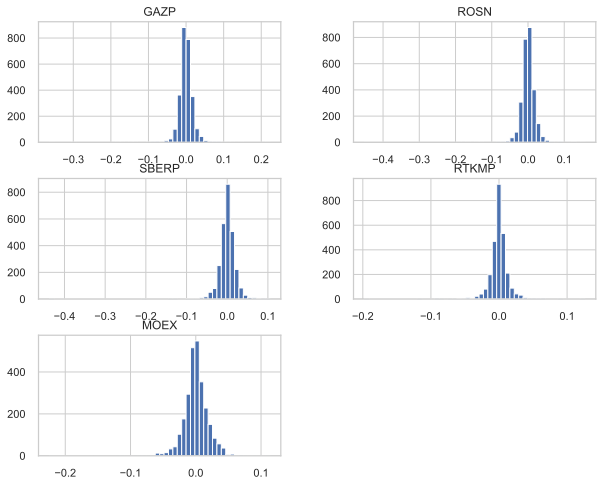

In [72]:
log_returns.hist(bins=50, figsize=(10, 8));

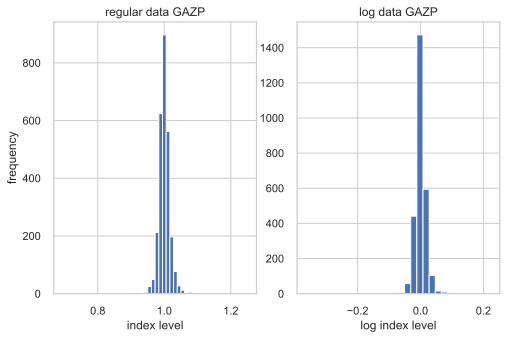

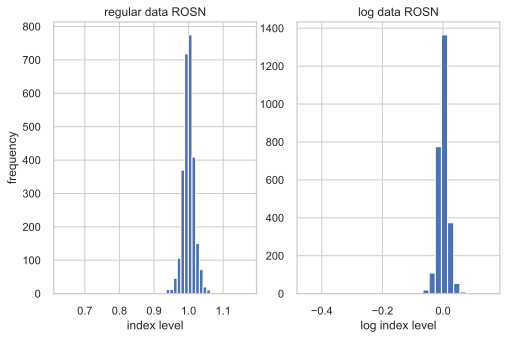

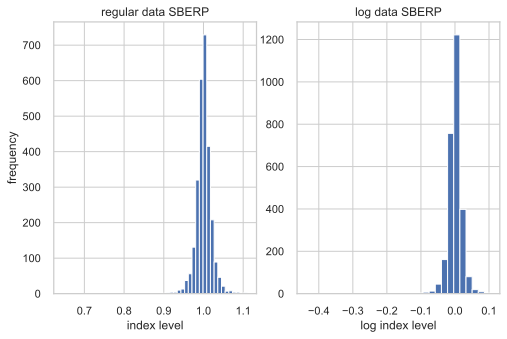

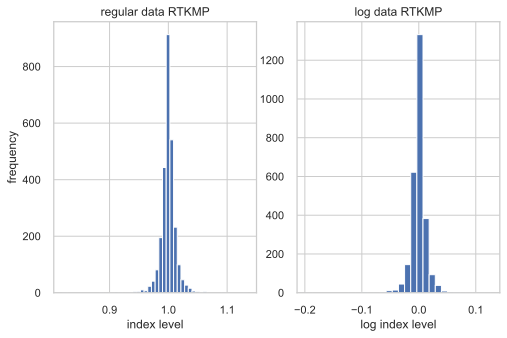

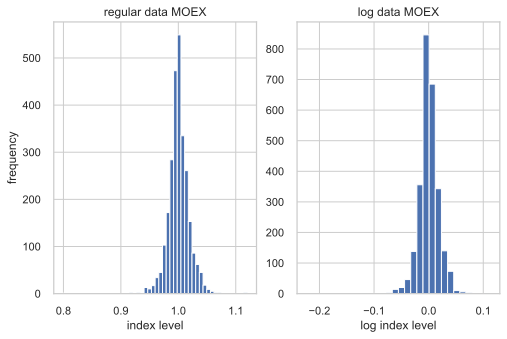

In [73]:
for i in stock:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 5))
    ax1.hist(returns[i], bins=50)
    ax1.set_xlabel('index level')
    ax1.set_ylabel('frequency')
    ax1.set_title(f'regular data {i}')
    ax2.hist(log_returns[i].values, bins=30)
    ax2.set_xlabel('log index level')
    ax2.set_title(f'log data {i}');

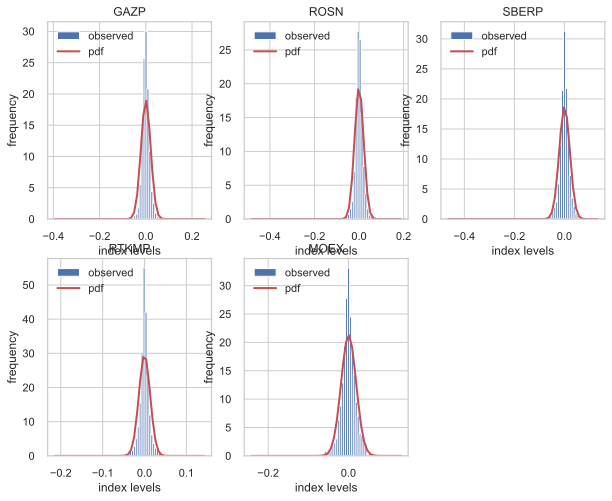

In [74]:
figure = plt.figure(figsize=(10, 8))

for k, i in enumerate(stock):
        figure.add_subplot(2, 3, k+1)
#         plt.figure(figsize=(10, 6))
        log_data = log_returns[i]
        plt.hist(log_data, bins=70, density=True,
                 label='observed', color='b')
        plt.xlabel('index levels')
        plt.ylabel('frequency')
        x = np.linspace(plt.axis()[0], plt.axis()[1])
        plt.plot(x, scs.norm.pdf(x, log_data.mean(), log_data.std()),
                 'r', lw=2.0, label='pdf')
        plt.title(i)
        plt.legend();
plt.show()

In [75]:
def print_statistics(array):
    ''' Prints selected statistics.
    
    Parameters
    ==========
    array: ndarray
        object to generate statistics on
    '''
    sta = scs.describe(array)
    print('%14s %15s' % ('statistic', 'value'))
    print(30 * '-')
    print('%14s %15.5f' % ('size', sta[0]))
    print('%14s %15.5f' % ('min', sta[1][0]))
    print('%14s %15.5f' % ('max', sta[1][1]))
    print('%14s %15.5f' % ('mean', sta[2]))
    print('%14s %15.5f' % ('std', np.sqrt(sta[3])))
    print('%14s %15.5f' % ('skew', sta[4]))
    print('%14s %15.5f' % ('kurtosis', sta[5]))

In [76]:
for i in stock:
    
    print('\nResults for symbol {}'.format(i))
    print(30 * '-')
    log_data = np.array(log_returns[i].dropna())
    print_statistics(log_data)  


Results for symbol GAZP
------------------------------
     statistic           value
------------------------------
          size      2720.00000
           min        -0.36320
           max         0.22275
          mean         0.00004
           std         0.02098
          skew        -2.82423
      kurtosis        60.55944

Results for symbol ROSN
------------------------------
     statistic           value
------------------------------
          size      2720.00000
           min        -0.45112
           max         0.15672
          mean         0.00029
           std         0.02038
          skew        -4.26401
      kurtosis        96.19124

Results for symbol SBERP
------------------------------
     statistic           value
------------------------------
          size      2720.00000
           min        -0.43679
           max         0.10467
          mean         0.00051
           std         0.02133
          skew        -3.75521
      kurtosis        70.

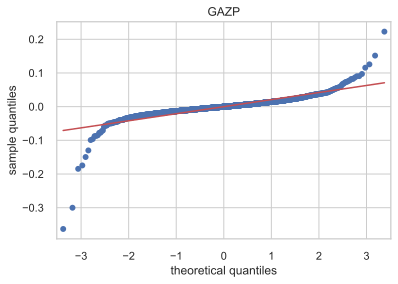

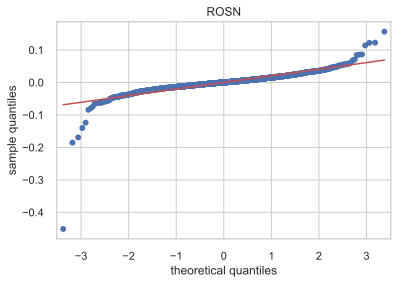

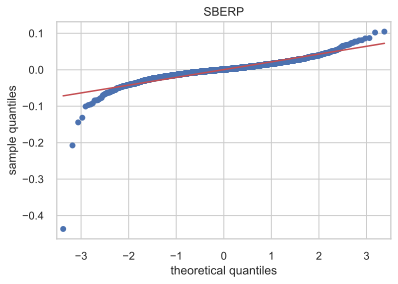

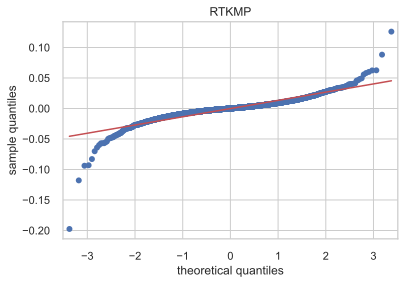

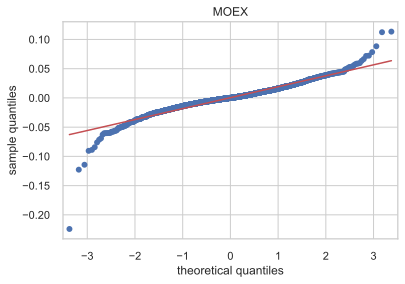

In [77]:
for k, i in enumerate(stock):
    sm.qqplot(log_returns[i].dropna(), line='s')
    plt.title(i)
    plt.xlabel('theoretical quantiles')
    plt.ylabel('sample quantiles');

In [78]:
def normality_tests(arr):
    ''' Tests for normality distribution of given data set.
    
    Parameters
    ==========
    array: ndarray
        object to generate statistics on
    '''
    print('Skew of data set  %14.3f' % scs.skew(arr))
    print('Skew test p-value %14.3f' % scs.skewtest(arr)[1])
    print('Kurt of data set  %14.3f' % scs.kurtosis(arr))
    print('Kurt test p-value %14.3f' % scs.kurtosistest(arr)[1])
    print('Norm test p-value %14.3f' % scs.normaltest(arr)[1])

In [79]:
for i in stock:
    print('\nResults for {}'.format(i))
    print(32 * '-')
    log_data = np.array(log_returns[i].dropna())
    normality_tests(log_data)  


Results for GAZP
--------------------------------
Skew of data set          -2.824
Skew test p-value          0.000
Kurt of data set          60.559
Kurt test p-value          0.000
Norm test p-value          0.000

Results for ROSN
--------------------------------
Skew of data set          -4.264
Skew test p-value          0.000
Kurt of data set          96.191
Kurt test p-value          0.000
Norm test p-value          0.000

Results for SBERP
--------------------------------
Skew of data set          -3.755
Skew test p-value          0.000
Kurt of data set          70.831
Kurt test p-value          0.000
Norm test p-value          0.000

Results for RTKMP
--------------------------------
Skew of data set          -1.456
Skew test p-value          0.000
Kurt of data set          26.631
Kurt test p-value          0.000
Norm test p-value          0.000

Results for MOEX
--------------------------------
Skew of data set          -0.758
Skew test p-value          0.000
Kurt of data set 

## Portfolio Optimization

In [80]:
symbols = stock

In [81]:
noa = len(symbols)

In [82]:
rets = np.log(data1 / data1.shift(1))

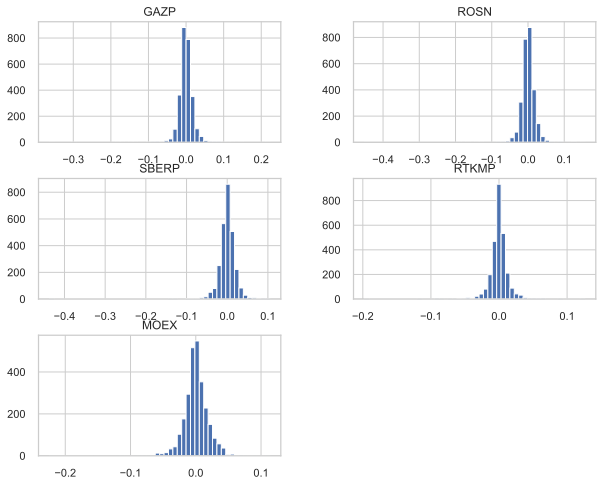

In [83]:
rets.hist(bins=50, figsize=(10, 8));

In [84]:
for i in stock:
     print(i, 'SMA2', df1.loc[i, 'SMA2'], rets[i].mean() * df1.loc[i, 'SMA2'])

GAZP SMA2 180 0.007823294378020249
ROSN SMA2 200 0.057130501458562896
SBERP SMA2 180 0.09173301558595376
RTKMP SMA2 210 -0.01722180637614542
MOEX SMA2 220 0.1066360737863678


In [85]:
rets.mean() * 220

GAZP     0.009562
ROSN     0.062844
SBERP    0.112118
RTKMP   -0.018042
MOEX     0.106636
dtype: float64

In [86]:
for i in stock:
         print(i, 'SMA2', df1.loc[i, 'SMA2'])
         display(rets.cov() * df1.loc[i, 'SMA2'])

GAZP SMA2 180


,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,0.079253,0.046029,0.045030,0.021730,0.028347
ROSN,0.046029,0.074767,0.047717,0.023319,0.029925
SBERP,0.045030,0.047717,0.081871,0.024012,0.036338
RTKMP,0.021730,0.023319,0.024012,0.032690,0.015948
MOEX,0.028347,0.029925,0.036338,0.015948,0.063173


ROSN SMA2 200


,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,0.088058,0.051143,0.050033,0.024144,0.031497
ROSN,0.051143,0.083074,0.053018,0.025910,0.033250
SBERP,0.050033,0.053018,0.090967,0.026680,0.040375
RTKMP,0.024144,0.025910,0.026680,0.036322,0.017720
MOEX,0.031497,0.033250,0.040375,0.017720,0.070192


SBERP SMA2 180


,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,0.079253,0.046029,0.045030,0.021730,0.028347
ROSN,0.046029,0.074767,0.047717,0.023319,0.029925
SBERP,0.045030,0.047717,0.081871,0.024012,0.036338
RTKMP,0.021730,0.023319,0.024012,0.032690,0.015948
MOEX,0.028347,0.029925,0.036338,0.015948,0.063173


RTKMP SMA2 210


,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,0.092461,0.053700,0.052535,0.025351,0.033072
ROSN,0.053700,0.087228,0.055669,0.027206,0.034912
SBERP,0.052535,0.055669,0.095516,0.028014,0.042394
RTKMP,0.025351,0.027206,0.028014,0.038138,0.018606
MOEX,0.033072,0.034912,0.042394,0.018606,0.073702


MOEX SMA2 220


,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,0.096864,0.056257,0.055036,0.026559,0.034647
ROSN,0.056257,0.091382,0.058320,0.028501,0.036575
SBERP,0.055036,0.058320,0.100064,0.029348,0.044413
RTKMP,0.026559,0.028501,0.029348,0.039954,0.019492
MOEX,0.034647,0.036575,0.044413,0.019492,0.077211


In [87]:
rets.cov() * 220

,GAZP,ROSN,SBERP,RTKMP,MOEX
GAZP,0.096864,0.056257,0.055036,0.026559,0.034647
ROSN,0.056257,0.091382,0.058320,0.028501,0.036575
SBERP,0.055036,0.058320,0.100064,0.029348,0.044413
RTKMP,0.026559,0.028501,0.029348,0.039954,0.019492
MOEX,0.034647,0.036575,0.044413,0.019492,0.077211


### The Basic Theory

In [88]:
weights = np.random.random(noa)  
weights /= np.sum(weights)  
weights

array([0.09142996, 0.26522646, 0.10281517, 0.45607375, 0.08445466])

In [89]:
weights.sum()

1.0

In [90]:
math.sqrt(np.dot(weights.T, np.dot(rets.cov() * 220, weights)))  

0.20102197030005253

In [91]:
for i in stock:
         print(i, 'SMA2 = ', df1.loc[i, 'SMA2'])
         print(np.sum(rets.mean() * weights) * df1.loc[i, 'SMA2'])

GAZP SMA2 =  180
0.024420217816907185
ROSN SMA2 =  200
0.027133575352119098
SBERP SMA2 =  180
0.024420217816907185
RTKMP SMA2 =  210
0.028490254119725052
MOEX SMA2 =  220
0.029846932887331007


In [92]:
np.sum(rets.mean() * weights) * 220

0.029846932887331007

In [93]:
for i in stock:
         print(i, 'SMA2', df1.loc[i, 'SMA2'])
         print(np.dot(weights.T, np.dot(rets.cov() * df1.loc[i, 'SMA2'], weights)) )

GAZP SMA2 180
0.03306259026271244
ROSN SMA2 200
0.03673621140301382
SBERP SMA2 180
0.03306259026271244
RTKMP SMA2 210
0.038573021973164506
MOEX SMA2 220
0.0404098325433152


In [94]:
np.dot(weights.T, np.dot(rets.cov() * 220, weights))

0.0404098325433152

In [95]:
for i in stock:
         print(i, 'SMA2', df1.loc[i, 'SMA2'])
         print(math.sqrt(np.dot(weights.T, np.dot(rets.cov() * df1.loc[i, 'SMA2'], weights))) )

GAZP SMA2 180
0.18183121366452032
ROSN SMA2 200
0.19166692829753865
SBERP SMA2 180
0.18183121366452032
RTKMP SMA2 210
0.19640015777275868
MOEX SMA2 220
0.20102197030005253


In [96]:
math.sqrt(np.dot(weights.T, np.dot(rets.cov() * 220, weights)))

0.20102197030005253

In [97]:
def port_ret(weights):
    return np.sum(rets.mean() * weights) * 220

In [98]:
def port_vol(weights):
    return np.sqrt(np.dot(weights.T, np.dot(rets.cov() * 220, weights)))

In [99]:
prets = []
pvols = []
for p in range (2500):  
    weights = np.random.random(noa)  
    weights /= np.sum(weights)  
    prets.append(port_ret(weights))  
    pvols.append(port_vol(weights))  
prets = np.array(prets)
pvols = np.array(pvols)

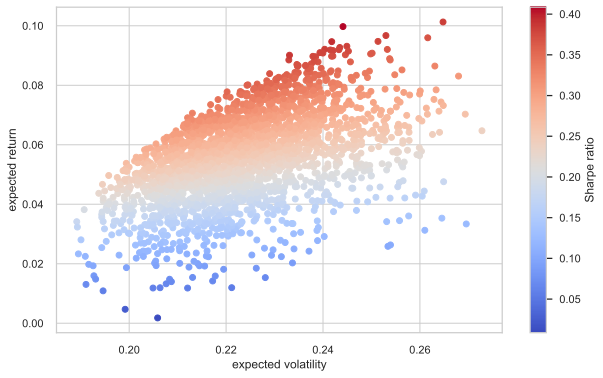

In [100]:
plt.figure(figsize=(10, 6))
plt.scatter(pvols, prets, c=prets / pvols,
            marker='o', cmap='coolwarm')
plt.xlabel('expected volatility')
plt.ylabel('expected return')
plt.colorbar(label='Sharpe ratio');

### Portfolio Optimizations

In [101]:
import scipy.optimize as sco

In [102]:
def min_func_sharpe(weights):  
    return -port_ret(weights) / port_vol(weights)  

In [103]:
cons = ({'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})  

In [104]:
bnds = tuple((0, 1) for x in range(noa))  

In [105]:
eweights = np.array(noa * [1. / noa,])  
eweights  

array([0.2, 0.2, 0.2, 0.2, 0.2])

In [106]:
min_func_sharpe(eweights)

-0.2510243601016583

In [107]:
%%time
opts = sco.minimize(min_func_sharpe, eweights,
                    method='SLSQP', bounds=bnds,
                    constraints=cons)  

CPU times: total: 62.5 ms
Wall time: 51 ms


In [108]:
opts

     fun: -0.42647233698817694
     jac: array([ 2.43695866e-01,  5.12170754e-02, -4.99188900e-06,  2.24537492e-01,
        3.44216824e-06])
 message: 'Optimization terminated successfully'
    nfev: 36
     nit: 6
    njev: 6
  status: 0
 success: True
       x: array([2.28858617e-17, 0.00000000e+00, 4.07901184e-01, 0.00000000e+00,
       5.92098816e-01])

In [109]:
opts['x'].round(3)  

array([0.   , 0.   , 0.408, 0.   , 0.592])

In [110]:
port_ret(opts['x']).round(3)  

0.109

In [111]:
port_vol(opts['x']).round(3)  

0.255

In [112]:
port_ret(opts['x']) / port_vol(opts['x'])  

0.42647233698817694

In [113]:
optv = sco.minimize(port_vol, eweights,
                    method='SLSQP', bounds=bnds,
                    constraints=cons)  

In [114]:
optv

     fun: 0.18459653426238684
     jac: array([0.18445655, 0.18466762, 0.19155122, 0.1846367 , 0.18450888])
 message: 'Optimization terminated successfully'
    nfev: 42
     nit: 7
    njev: 7
  status: 0
 success: True
       x: array([0.06796717, 0.02988343, 0.        , 0.67645548, 0.22569393])

In [115]:
optv['x'].round(3)

array([0.068, 0.03 , 0.   , 0.676, 0.226])

In [116]:
port_vol(optv['x']).round(3)

0.185

In [117]:
port_ret(optv['x']).round(3)

0.014

In [118]:
port_ret(optv['x']) / port_vol(optv['x'])

0.07795621504566184

### Efficient Frontier

In [119]:
cons = ({'type': 'eq', 'fun': lambda x:  port_ret(x) - tret},
        {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})  

In [120]:
bnds = tuple((0, 1) for x in weights)

In [121]:
%%time
trets = np.linspace(0.05, 0.2, 50)
tvols = []
for tret in trets:
    res = sco.minimize(port_vol, eweights, method='SLSQP',
                       bounds=bnds, constraints=cons)  
    tvols.append(res['fun'])
tvols = np.array(tvols)

CPU times: total: 6.05 s
Wall time: 6.1 s


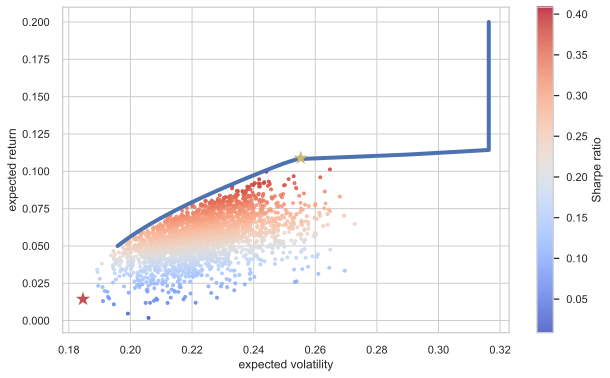

In [122]:
plt.figure(figsize=(10, 6))
plt.scatter(pvols, prets, c=prets / pvols,
            marker='.', alpha=0.8, cmap='coolwarm')
plt.plot(tvols, trets, 'b', lw=4.0)
plt.plot(port_vol(opts['x']), port_ret(opts['x']),
         'y*', markersize=15.0)
plt.plot(port_vol(optv['x']), port_ret(optv['x']),
         'r*', markersize=15.0)
plt.xlabel('expected volatility')
plt.ylabel('expected return')
plt.colorbar(label='Sharpe ratio');